<a href="https://colab.research.google.com/github/tiravata/2014-slides/blob/master/120_detectron2.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

<img height="45px" src="https://avatars3.githubusercontent.com/u/20337240?s=460&v=4" align="left" hspace="10px" vspace="0px">

# การใช้ Detectron2 ของ Facebook


ความสามารถเช่น
* Object dectection
* Segmentation
* Pose estimate


<hr>
<a href='https://www.facebook.com/programmerthai'><font color='green'>สรุปและเรียบเรียงโดย โปรแกรมเมอร์ไทย thai programmer</font></a>

I copy code from

cite

* https://colab.research.google.com/drive/16jcaJoc6bCFAQ96jDe2HwtXj7BMD_-m5

* https://github.com/facebookresearch/detectron2

# วิธีใช้งาน colab

Colab พัฒนาโดย google เป็นหน้าเว็บเอาไว้ใช้เขียนโค้ด python ได้ผ่านทางหน้าเว็บ และเชื่อมต่อกับ google drive ของเราก็ได้ด้วย ซึ่ง colab หน้านี้**ได้รวบรวมเนื้อหา Python ของม.ต้น** เอาไว้ แต่ก่อนอื่นอยากให้ดูวิธีการใช้งาน colab เสียก่อน

<font color='red'>** ต้องมี Gmail และ google drive</font>

<hr/>

<h3>วิธี 1) กด "Open in playgrouhd"</h3>
<div>
<img height="200px" src="https://www.patanasongsivilai.com/blog/wp-content/uploads/2020/05/python_matayom_4.png" align="center" hspace="10px" vspace="0px">


<hr/>

<h3>วิธี 2) กด Save a copy in Drive ... เพื่อบันทึกไว้ google drive เครื่องเรา</h3>

<img height="300px" src="https://www.patanasongsivilai.com/blog/wp-content/uploads/2019/11/python_matayom_1.png" align="center" hspace="10px" vspace="0px">

<br/>

<img height="200px" src="https://www.patanasongsivilai.com/blog/wp-content/uploads/2019/11/python_matayom_2.png" align="center" hspace="10px" vspace="0px">

<hr/>

<h3>จากนั้นถึงจะสามารถรันได้</h3>
<img height="200px" src="https://www.patanasongsivilai.com/blog/wp-content/uploads/2019/11/python_matayom_3.png" align="center" hspace="10px" vspace="0px">

# Install detectron2

In [ ]:
# install dependencies: (use cu101 because colab has CUDA 10.1)
!pip install -U torch==1.5 torchvision==0.6 -f https://download.pytorch.org/whl/cu101/torch_stable.html 
!pip install cython pyyaml==5.1
!pip install -U 'git+https://github.com/cocodataset/cocoapi.git#subdirectory=PythonAPI'
import torch, torchvision
print(torch.__version__, torch.cuda.is_available())
!gcc --version
# opencv is pre-installed on colab

Looking in links: https://download.pytorch.org/whl/cu101/torch_stable.html
Requirement already up-to-date: torch==1.5 in /usr/local/lib/python3.6/dist-packages (1.5.0+cu101)
Requirement already up-to-date: torchvision==0.6 in /usr/local/lib/python3.6/dist-packages (0.6.0+cu101)
  Cloning https://github.com/cocodataset/cocoapi.git to /tmp/pip-req-build-h464oub1
  Running command git clone -q https://github.com/cocodataset/cocoapi.git /tmp/pip-req-build-h464oub1
  Created wheel for pycocotools: filename=pycocotools-2.0-cp36-cp36m-linux_x86_64.whl size=275269 sha256=36618e6e8dc65f32181b7bb1de5931424b85ff7f66a9e30542567f8ce56926ab
  Stored in directory: /tmp/pip-ephem-wheel-cache-ig4tgm1y/wheels/90/51/41/646daf401c3bc408ff10de34ec76587a9b3ebfac8d21ca5c3a
Successfully built pycocotools
  Found existing installation: pycocotools 2.0
    Uninstalling pycocotools-2.0:
      Successfully uninstalled pycocotools-2.0


1.5.0+cu101 True
gcc (Ubuntu 7.5.0-3ubuntu1~18.04) 7.5.0
Copyright (C) 2017 Free Software Foundation, Inc.
This is free software; see the source for copying conditions.  There is NO
warranty; not even for MERCHANTABILITY or FITNESS FOR A PARTICULAR PURPOSE.



In [ ]:
# install detectron2:
!pip install detectron2==0.1.2 -f https://dl.fbaipublicfiles.com/detectron2/wheels/cu101/index.html

Looking in links: https://dl.fbaipublicfiles.com/detectron2/wheels/cu101/index.html


In [ ]:
# You may need to restart your runtime prior to this, to let your installation take effect
# Some basic setup:
# Setup detectron2 logger
import detectron2
from detectron2.utils.logger import setup_logger
setup_logger()

# import some common libraries
import numpy as np
import cv2
import random
from google.colab.patches import cv2_imshow

# import some common detectron2 utilities
from detectron2 import model_zoo
from detectron2.engine import DefaultPredictor
from detectron2.config import get_cfg
from detectron2.utils.visualizer import Visualizer
from detectron2.data import MetadataCatalog

# Run a pre-trained detectron2 model

ดาวน์โหลดตัวอย่างภาพ

--2020-05-14 03:30:20--  https://f.ptcdn.info/865/056/000/p6fvi3t67BJjiCMYrmB-o.png
Resolving f.ptcdn.info (f.ptcdn.info)... 136.243.138.66, 188.40.113.83, 2a01:4f8:212:3a03::2, ...
Connecting to f.ptcdn.info (f.ptcdn.info)|136.243.138.66|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 493655 (482K) [image/png]
Saving to: ‘input.jpg’

input.jpg           100%[===================>] 482.08K   297KB/s    in 1.6s    

2020-05-14 03:30:24 (297 KB/s) - ‘input.jpg’ saved [493655/493655]



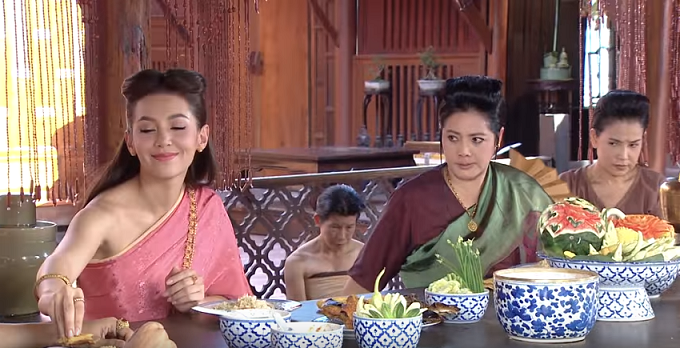

In [ ]:
#!wget http://images.cocodataset.org/val2017/000000439715.jpg -O input.jpg
!wget https://f.ptcdn.info/865/056/000/p6fvi3t67BJjiCMYrmB-o.png -O input.jpg

im = cv2.imread("./input.jpg")
cv2_imshow(im)

Then, we create a detectron2 config and a detectron2 DefaultPredictor to run inference on this image.


In [ ]:
cfg = get_cfg()
# add project-specific config (e.g., TensorMask) here if you're not running a model in detectron2's core library
cfg.merge_from_file(model_zoo.get_config_file("COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml"))
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.5  # set threshold for this model
# Find a model from detectron2's model zoo. You can use the https://dl.fbaipublicfiles... url as well
cfg.MODEL.WEIGHTS = model_zoo.get_checkpoint_url("COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml")
predictor = DefaultPredictor(cfg)
outputs = predictor(im)

In [ ]:
# look at the outputs. See https://detectron2.readthedocs.io/tutorials/models.html#model-output-format for specification
outputs["instances"].pred_classes
outputs["instances"].pred_boxes

Boxes(tensor([[ 27.5415,  68.2811, 255.3145, 334.7144],
        [341.8444,  77.4962, 551.4920, 300.3899],
        [551.9579,  89.0191, 665.5440, 215.8669],
        [280.3518, 181.8561, 371.0491, 299.4226],
        [423.7395, 282.2119, 489.3510, 322.4211],
        [269.6161, 321.5027, 344.9065, 347.8026],
        [217.3179, 308.0012, 289.5345, 347.1456],
        [352.9274, 306.0619, 423.2652, 346.2756],
        [535.8218, 209.5067, 679.6729, 303.5784],
        [416.4601,  46.2322, 446.9352,  91.2919],
        [493.5873, 264.0786, 600.0340, 342.6241],
        [223.3862, 294.7371, 273.7995, 310.0160],
        [659.0736, 171.2112, 679.7046, 234.8393],
        [129.0546, 260.1231, 680.0000, 347.9394],
        [194.4705, 299.1008, 300.0929, 331.8559],
        [351.9975, 294.0717, 424.8911, 329.9795]], device='cuda:0'))

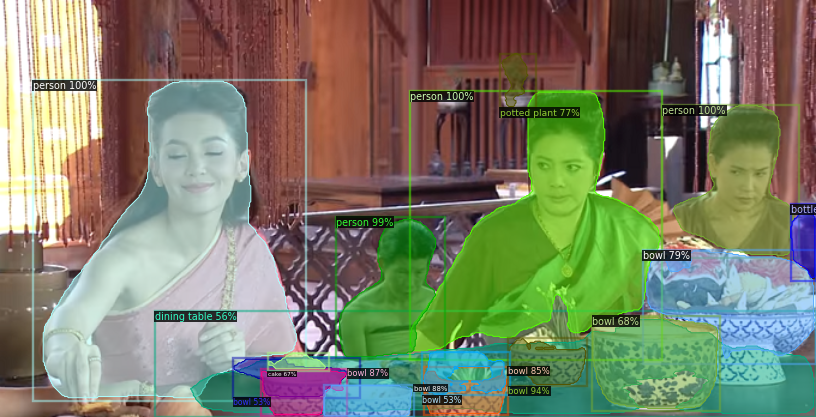

In [ ]:
# We can use `Visualizer` to draw the predictions on the image.
v = Visualizer(im[:, :, ::-1], MetadataCatalog.get(cfg.DATASETS.TRAIN[0]), scale=1.2)
v = v.draw_instance_predictions(outputs["instances"].to("cpu"))
cv2_imshow(v.get_image()[:, :, ::-1])

# Other types of builtin models

**ตัวอย่างภาพเอาไว้ทำ pose estimate**

--2020-05-14 03:30:32--  https://img.kapook.com/image/Artist2/61.jpg
Resolving img.kapook.com (img.kapook.com)... 27.254.43.244, 202.183.165.200, 202.183.165.168
Connecting to img.kapook.com (img.kapook.com)|27.254.43.244|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 34679 (34K) [image/jpeg]
Saving to: ‘input.jpg’

input.jpg           100%[===================>]  33.87K  --.-KB/s    in 0s      

2020-05-14 03:30:32 (257 MB/s) - ‘input.jpg’ saved [34679/34679]



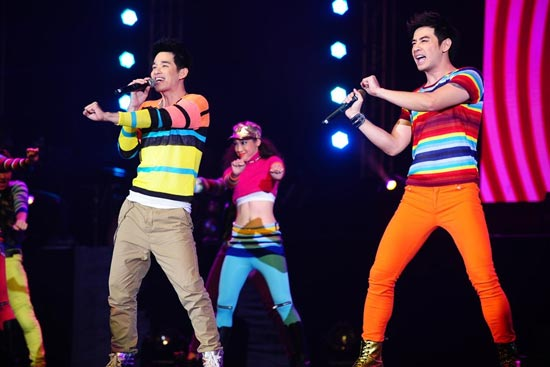

In [ ]:
!wget https://img.kapook.com/image/Artist2/61.jpg -O input.jpg

im = cv2.imread("./input.jpg")
cv2_imshow(im)

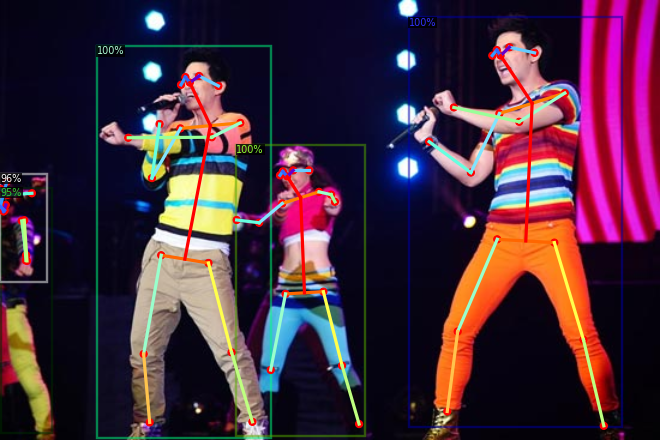

In [ ]:
# Inference with a keypoint detection model
cfg = get_cfg()
cfg.merge_from_file(model_zoo.get_config_file("COCO-Keypoints/keypoint_rcnn_R_50_FPN_3x.yaml"))
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.7  # set threshold for this model
cfg.MODEL.WEIGHTS = model_zoo.get_checkpoint_url("COCO-Keypoints/keypoint_rcnn_R_50_FPN_3x.yaml")
predictor = DefaultPredictor(cfg)
outputs = predictor(im)
v = Visualizer(im[:,:,::-1], MetadataCatalog.get(cfg.DATASETS.TRAIN[0]), scale=1.2)
v = v.draw_instance_predictions(outputs["instances"].to("cpu"))
cv2_imshow(v.get_image()[:, :, ::-1])

# Run panoptic segmentation on a video


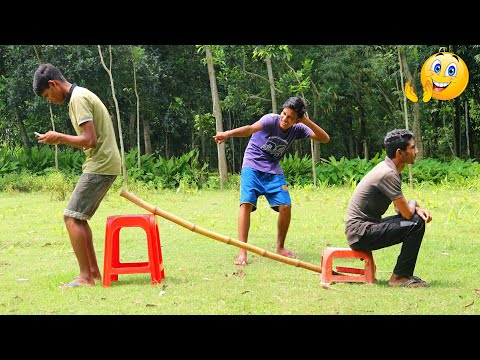

In [ ]:
# This is the video we're going to process
from IPython.display import YouTubeVideo, display
video = YouTubeVideo("tI6FaYxnRVc", width=500)
display(video)

In [ ]:
# Install dependencies, download the video, and crop 5 seconds for processing
!pip install youtube-dl
!pip uninstall -y opencv-python opencv-contrib-python
!apt install python3-opencv  # the one pre-installed have some issues
!youtube-dl https://youtu.be/tI6FaYxnRVc -f 22 -o video.mp4
!ffmpeg -i video.mp4 -t 00:00:06 -c:v copy video-clip.mp4

Reading package lists... Done
Building dependency tree       
Reading state information... Done
python3-opencv is already the newest version (3.2.0+dfsg-4ubuntu0.1).
0 upgraded, 0 newly installed, 0 to remove and 29 not upgraded.
[youtube] tI6FaYxnRVc: Downloading webpage
[download] video.mp4 has already been downloaded
[download] 100% of 49.46MiB
ffmpeg version 3.4.6-0ubuntu0.18.04.1 Copyright (c) 2000-2019 the FFmpeg developers
  built with gcc 7 (Ubuntu 7.3.0-16ubuntu3)
  configuration: --prefix=/usr --extra-version=0ubuntu0.18.04.1 --toolchain=hardened --libdir=/usr/lib/x86_64-linux-gnu --incdir=/usr/include/x86_64-linux-gnu --enable-gpl --disable-stripping --enable-avresample --enable-avisynth --enable-gnutls --enable-ladspa --enable-libass --enable-libbluray --enable-libbs2b --enable-libcaca --enable-libcdio --enable-libflite --enable-libfontconfig --enable-libfreetype --enable-libfribidi --enable-libgme --enable-libgsm --enable-libmp3lame --enable-libmysofa --enable-libopenjpeg 

In [ ]:
# Run frame-by-frame inference demo on this video (takes 3-4 minutes)
# Using a model trained on COCO dataset
!git clone https://github.com/facebookresearch/detectron2
!python detectron2/demo/demo.py --config-file detectron2/configs/COCO-PanopticSegmentation/panoptic_fpn_R_101_3x.yaml --video-input video-clip.mp4 --confidence-threshold 0.6 --output video-output.mkv \
  --opts MODEL.WEIGHTS detectron2://COCO-PanopticSegmentation/panoptic_fpn_R_101_3x/139514519/model_final_cafdb1.pkl

fatal: destination path 'detectron2' already exists and is not an empty directory.
Failed to load OpenCL runtime
[05/14 03:31:36 detectron2]: Arguments: Namespace(confidence_threshold=0.6, config_file='detectron2/configs/COCO-PanopticSegmentation/panoptic_fpn_R_101_3x.yaml', input=None, opts=['MODEL.WEIGHTS', 'detectron2://COCO-PanopticSegmentation/panoptic_fpn_R_101_3x/139514519/model_final_cafdb1.pkl'], output='video-output.mkv', video_input='video-clip.mp4', webcam=False)
[05/14 03:31:41 fvcore.common.checkpoint]: Loading checkpoint from detectron2://COCO-PanopticSegmentation/panoptic_fpn_R_101_3x/139514519/model_final_cafdb1.pkl
[05/14 03:31:41 fvcore.common.file_io]: URL https://dl.fbaipublicfiles.com/detectron2/COCO-PanopticSegmentation/panoptic_fpn_R_101_3x/139514519/model_final_cafdb1.pkl cached in /root/.torch/fvcore_cache/detectron2/COCO-PanopticSegmentation/panoptic_fpn_R_101_3x/139514519/model_final_cafdb1.pkl
[05/14 03:31:42 fvcore.common.checkpoint]: Reading a file from '

In [ ]:
from IPython.display import HTML
from base64 import b64encode

video_encoded = open( 'video-output.mkv', "rb").read()
data_url = "data:video/mp4;base64," + b64encode(video_encoded).decode()
HTML('<video width=500 controls> <source src="%s" type="video/mp4"></video>' % data_url)

In [ ]:
# Download the results
'''
from google.colab import files
files.download('video-output.mkv')
'''

"\nfrom google.colab import files\nfiles.download('video-output.mkv')\n"

# ลบภาพด้านหลังออก (Remove background)

ดาวน์โหลดภาพตัวอย่าง

--2020-05-14 03:31:49--  http://newtv.co.th/images/content/ct_20180328042412228.jpg
Resolving newtv.co.th (newtv.co.th)... 103.253.135.140
Connecting to newtv.co.th (newtv.co.th)|103.253.135.140|:80... connected.
HTTP request sent, awaiting response... 200 OK
Length: 353901 (346K) [image/jpeg]
Saving to: ‘input.jpg’

input.jpg           100%[===================>] 345.61K  1.61MB/s    in 0.2s    

2020-05-14 03:31:50 (1.61 MB/s) - ‘input.jpg’ saved [353901/353901]



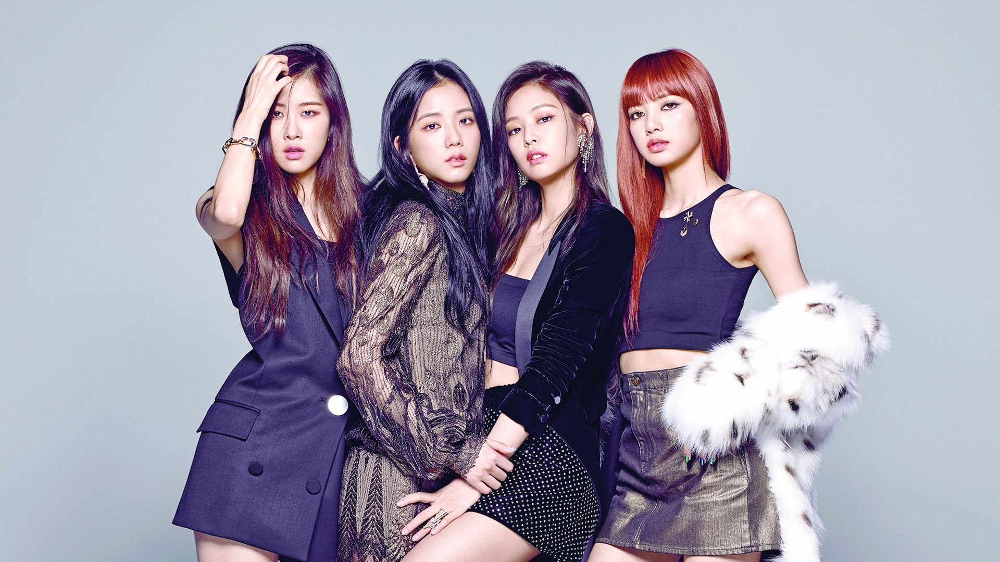

In [ ]:
!wget http://newtv.co.th/images/content/ct_20180328042412228.jpg -O input.jpg
im = cv2.imread("./input.jpg")
cv2_imshow(im)

In [ ]:
cfg = get_cfg()
# add project-specific config (e.g., TensorMask) here if you're not running a model in detectron2's core library
cfg.merge_from_file(model_zoo.get_config_file("COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml"))
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.5  # set threshold for this model
# Find a model from detectron2's model zoo. You can use the https://dl.fbaipublicfiles... url as well
cfg.MODEL.WEIGHTS = model_zoo.get_checkpoint_url("COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml")
predictor = DefaultPredictor(cfg)
outputs = predictor(im)

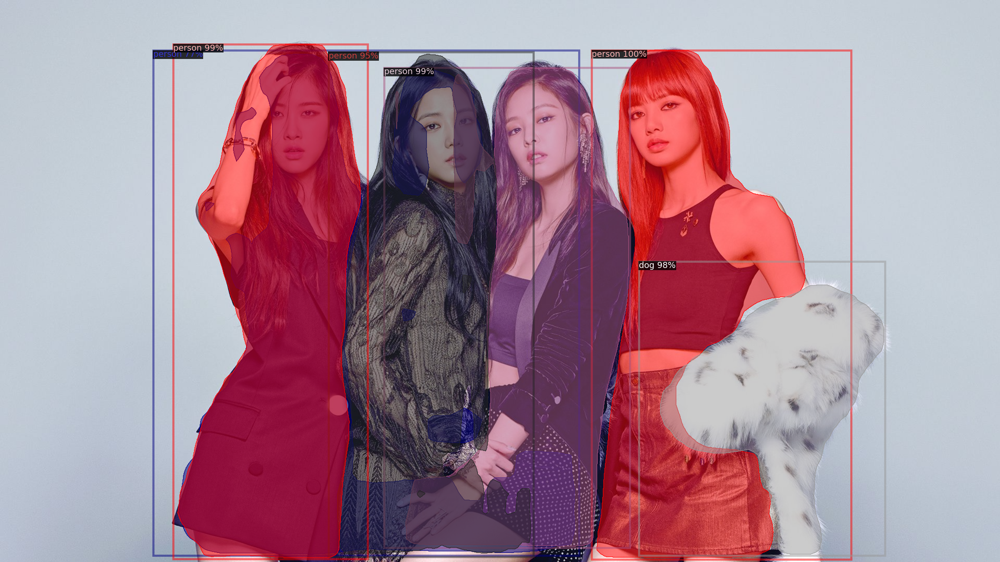

In [ ]:
# We can use `Visualizer` to draw the predictions on the image.
v = Visualizer(im[:, :, ::-1], MetadataCatalog.get(cfg.DATASETS.TRAIN[0]), scale=1.2)
v = v.draw_instance_predictions(outputs["instances"].to("cpu"))
cv2_imshow(v.get_image()[:, :, ::-1])

**ลบภาพพื้นหลังออก**

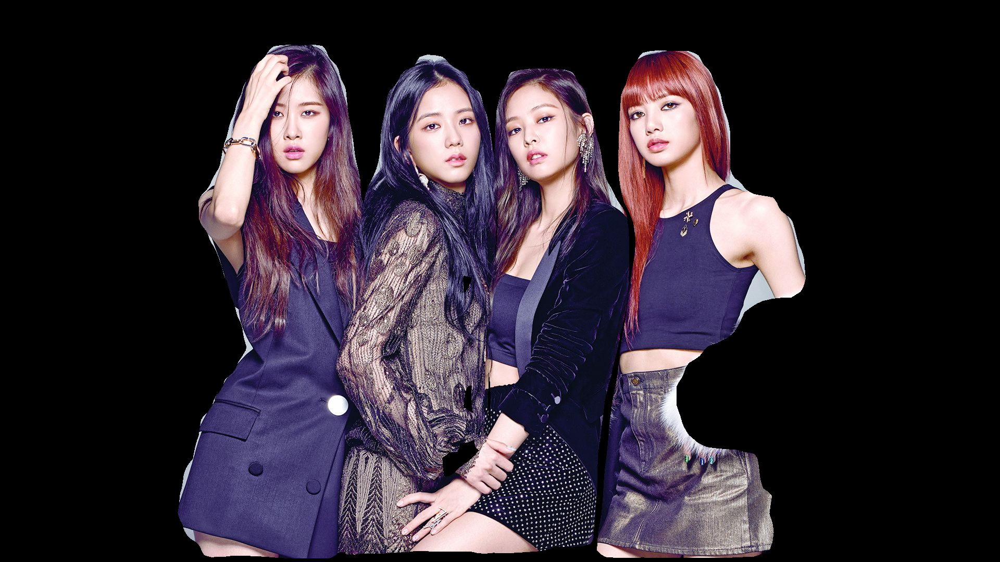

In [ ]:
instances = outputs['instances']
classes = instances.pred_classes
index_person = torch.nonzero(classes == 0)

pred_masks = instances.pred_masks[ index_person ].cpu().numpy()

h, w, c = np.shape(im)
#masks = np.zeros( (h, w, c))
merge_masks = np.zeros( (h, w))

# กรณีตรวจสอบเจอหลายคนในรูป ก็จมีหลาย masks
for m in pred_masks:
  merge_masks = np.logical_or(m[0],merge_masks)

'''
masks[:, :, 0] = merge_masks
masks[:, :, 1] = merge_masks
masks[:, :, 2] = merge_masks
'''
masks = np.stack((merge_masks,)*3, axis=-1)
masks = masks.astype('uint8')

cv2_imshow(im * masks)

เปลี่ยนภาพพื้นหลังสีขาว

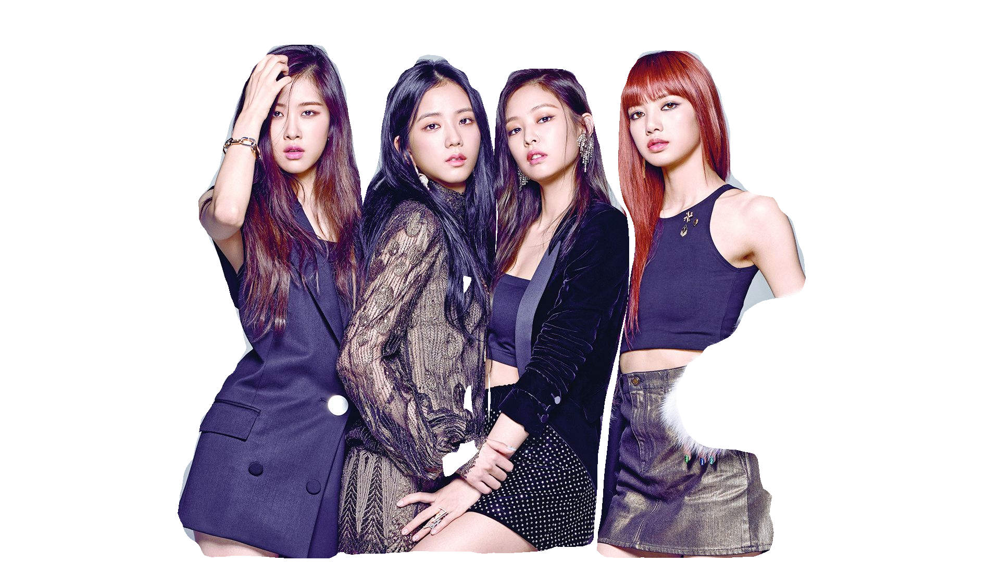

In [ ]:
bg = 255 - masks * 255
cv2_imshow(im*masks + bg)

# เปลี่ยนภาพพื้นหลัง

**ดาวน์โหลดภาพพื้นหลัง**

In [ ]:
!wget https://travel.mthai.com/app/uploads/2018/07/Sunflower-Field-9.jpg -O background.jpg

--2020-05-14 03:32:08--  https://travel.mthai.com/app/uploads/2018/07/Sunflower-Field-9.jpg
Resolving travel.mthai.com (travel.mthai.com)... 110.164.205.184
Connecting to travel.mthai.com (travel.mthai.com)|110.164.205.184|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 96581 (94K) [image/jpeg]
Saving to: ‘background.jpg’

background.jpg      100%[===================>]  94.32K  --.-KB/s    in 0.06s   

2020-05-14 03:32:08 (1.57 MB/s) - ‘background.jpg’ saved [96581/96581]



**เปลี่ยนภาพเบื้องหลัง**

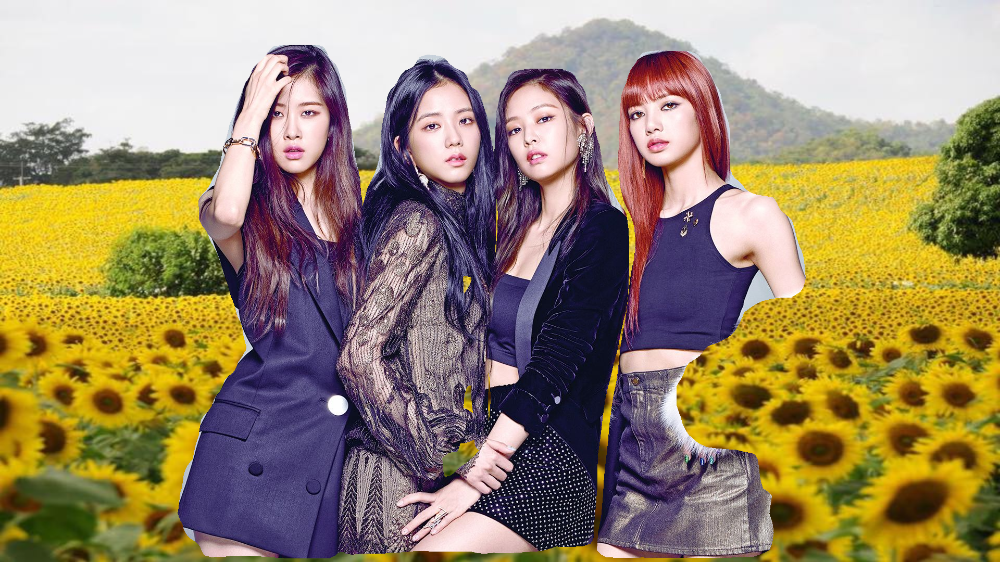

In [ ]:
background = cv2.imread('./background.jpg')
h, w ,_ = np.shape(im)

background = cv2.resize(background, (w, h))

revert_masks = np.logical_not(masks)
cv2_imshow( masks*im + revert_masks*background )

# ฝากติดตาม

<img height="20px" src="https://www.patanasongsivilai.com/blog/wp-content/uploads/2017/06/logo_facebook2.png" align="left" hspace="10px" vspace="0px">  https://www.facebook.com/programmerthai/

<img height="14px" src="https://www.patanasongsivilai.com/blog/wp-content/uploads/2019/03/youtube.png" align="left" hspace="10px" vspace="3px">  https://www.youtube.com/channel/UCvhCKtG5cRE6K5--RJPql_w

<img height="14px" src="https://www.patanasongsivilai.com/blog/wp-content/uploads/2019/09/github-2.jpg" align="left" hspace="10px" vspace="3px">https://github.com/adminho/machine-learning

In [ ]:
#@title ฝากประชาสัมพันธ์ หนังสือ AI (ปัญญาประดิษฐ์) ไม่ยาก เรียนรู้ได้ด้วยเลขม. ปลาย ราคา 295 บาท
%%HTML
<iframe src="https://www.facebook.com/plugins/post.php?href=https%3A%2F%2Fwww.facebook.com%2Fprogrammerthai%2Fphotos%2Fa.2410667485889755%2F2555677101388792%2F%3Ftype%3D3&width=500" width="500" height="588" style="border:none;overflow:hidden" scrolling="no" frameborder="0" allowTransparency="true" allow="encrypted-media"></iframe>